# Visualisations

In [1]:
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt
import sys

sys.path.append('../hydra_tod/')

from astropy.coordinates import EarthLocation, AltAz, SkyCoord
from astropy.time import Time, TimeDelta
import astropy.units as u
from utils import Leg_poly_proj, view_samples
from flicker_model import sim_noise, flicker_cov
from simulation import * 

In [2]:
import pickle
with open('tod_simulation_single.pkl', 'rb') as f:
    tod_sim = pickle.load(f)
# Load the simulation data from a pickle file
with open('multi_tod_simulation_data.pkl', 'rb') as f:
    multi_tod_sim = pickle.load(f)

In [3]:
alpha = 2.0
logf0=-4.874571109426952
gain_params_setting = np.array([6.31194264, 0.42038942, 0.264222, 0.05578821])
gain_params_rising = np.array([6.84507868, 0.14156859, 0.7441104, 0.77863955])
rec_params = np.array([15.0, 12.6, 0.5, 0.5, 0.5])

In [4]:
true_others_1 = np.hstack((gain_params_setting, rec_params, [logf0, alpha]))
true_others_2 = np.hstack((gain_params_setting, gain_params_rising, rec_params, rec_params, [logf0, alpha], [logf0, alpha]))

In [5]:
# Read the saved samples

GS1_Tsys_samples = np.load('outputs/GS1/Tsys_samples.npy')
GS1_gain_samples = np.load('outputs/GS1/gain_samples.npy')
GS1_noise_samples = np.load('outputs/GS1/noise_samples.npy')
GS1_Tsky = GS1_Tsys_samples[:, :-5]
GS1_others = np.hstack((GS1_gain_samples[0],  GS1_Tsys_samples[:, -5:], GS1_noise_samples[0]))
GS1_all = np.hstack((GS1_Tsky, GS1_others))

GS5_Tsys_samples = np.load('outputs/GS5/Tsys_samples.npy')
GS5_gain_samples = np.load('outputs/GS5/gain_samples.npy')
GS5_noise_samples = np.load('outputs/GS5/noise_samples.npy')
GS5_Tsky = GS5_Tsys_samples[:, :-5]
GS5_others = np.hstack((GS5_gain_samples[0], GS5_Tsys_samples[:, -5:], GS5_noise_samples[0]))
GS5_all = np.hstack((GS5_Tsky, GS5_others))

GSF5_Tsys_samples = np.load('outputs/GSF5/Tsys_samples.npy')
GSF5_gain_samples = np.load('outputs/GSF5/gain_samples.npy')
GSF5_noise_samples = np.load('outputs/GSF5/noise_samples.npy')
GSF5_Tsky = GSF5_Tsys_samples[:, :-5]
GSF5_others = np.hstack((GSF5_gain_samples[0], GSF5_Tsys_samples[:, -5:], GSF5_noise_samples[0]))
GSF5_all = np.hstack((GSF5_Tsky, GSF5_others))

GS1_db_Tsys_samples = np.load('outputs/GS1_db/Tsys_samples.npy')
GS1_db_gain_samples = np.load('outputs/GS1_db/gain_samples.npy')
GS1_db_noise_samples = np.load('outputs/GS1_db/noise_samples.npy')
GS1_db_Tsky = GS1_db_Tsys_samples[:, :-10]
GS1_db_others = np.hstack((GS1_db_gain_samples[0], GS1_db_gain_samples[1], GS1_db_Tsys_samples[:, -10:], 
                           GS1_db_noise_samples[0], GS1_db_noise_samples[1]))
GS1_db_all = np.hstack((GS1_db_Tsky, GS1_db_others))

GS5_db_Tsys_samples = np.load('outputs/GS5_db/Tsys_samples.npy')
GS5_db_gain_samples = np.load('outputs/GS5_db/gain_samples.npy')
GS5_db_noise_samples = np.load('outputs/GS5_db/noise_samples.npy')
GS5_db_Tsky = GS5_db_Tsys_samples[:, :-10]
GS5_db_others = np.hstack((GS5_db_gain_samples[0], GS5_db_gain_samples[1], GS5_db_Tsys_samples[:, -10:], 
                           GS5_db_noise_samples[0], GS5_db_noise_samples[1]))
GS5_db_all = np.hstack((GS5_db_Tsky, GS5_db_others))

GSF5_db_Tsys_samples = np.load('outputs/GSF5_db/Tsys_samples.npy')
GSF5_db_gain_samples = np.load('outputs/GSF5_db/gain_samples.npy')
GSF5_db_noise_samples = np.load('outputs/GSF5_db/noise_samples.npy')
GSF5_db_Tsky = GSF5_db_Tsys_samples[:, :-10]
GSF5_db_others = np.hstack((GSF5_db_gain_samples[0], GSF5_db_gain_samples[1], GSF5_db_Tsys_samples[:, -10:], 
                           GSF5_db_noise_samples[0], GSF5_db_noise_samples[1]))
GSF5_db_all = np.hstack((GSF5_db_Tsky, GSF5_db_others))

# Parameter Correlation Visualizations

This section demonstrates two methods for visualizing parameter correlations:
1. **Correlation Matrix Plot**: Direct visualization of the correlation matrix as a heatmap
2. **Chord Plot**: Interactive visualization showing relationships between parameters

We'll use sample data from different analysis runs (GS1, GS5, GSF5, and their "_db" variants).

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
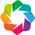

Required packages imported successfully!


In [6]:
# Install required packages for correlation visualizations
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr
import pandas as pd

# For chord plots
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')

print("Required packages imported successfully!")

In [7]:
aux_titles = [
    "1×TOD \n 1 CalSrc" + "\n\n" + "Latitude",
    "1×TOD \n 5 CalSrc" + "\n\n" + "Latitude",
    "1×TOD \n 5 CalSrc + 1/f prior" + "\n\n" + "Latitude",
    "2×TOD \n 1 CalSrc" + "\n\n" + "Latitude",
    "2×TOD \n 5 CalSrc" + "\n\n" + "Latitude",
    "2×TOD \n 5 CalSrc + 1/f prior" + "\n\n" + "Latitude"
]

In [8]:
def plot_large_correlation_matrix(samples, title="Large Correlation Matrix", param_names=None, 
                                figsize=(12, 10), show_values=False, value_threshold=0.5, ftsize=12,
                                cluster_params=True, annot_fontsize=6):
    """
    Plot correlation matrix optimized for large parameter spaces
    
    Parameters:
    -----------
    samples : array-like, shape (N_samples, N_params)
        2D array of parameter samples
    title : str
        Title for the plot
    param_names : list, optional
        Names of parameters. If None, uses generic names
    figsize : tuple
        Figure size
    show_values : bool
        Whether to show correlation values as text (only for small matrices)
    value_threshold : float
        Only show values with |correlation| > threshold
    cluster_params : bool
        Whether to cluster parameters by similarity
    annot_fontsize : int
        Font size for annotations
    """
    samples = np.array(samples)
    n_samples, n_params = samples.shape
    
    # Create parameter names if not provided
    if param_names is None:
        param_names = [f'P{i+1}' for i in range(n_params)]
    
    # Calculate correlation matrix
    corr_matrix = np.corrcoef(samples.T)
    
    # Optional clustering to group similar parameters
    if cluster_params and n_params > 10:
        from scipy.cluster.hierarchy import linkage, dendrogram, leaves_list
        from scipy.spatial.distance import squareform
        
        # Use correlation distance for clustering
        distance_matrix = 1 - np.abs(corr_matrix)
        condensed_distances = squareform(distance_matrix, checks=False)
        linkage_matrix = linkage(condensed_distances, method='average')
        cluster_order = leaves_list(linkage_matrix)
        
        # Reorder correlation matrix and parameter names
        corr_matrix = corr_matrix[cluster_order][:, cluster_order]
        param_names = [param_names[i] for i in cluster_order]
    
    # Create the plot
    fig, ax = plt.subplots(figsize=figsize)
    
    # Plot heatmap with better colormap for large matrices
    im = ax.imshow(corr_matrix, cmap='RdBu_r', vmin=-1, vmax=1, aspect='equal', 
                   interpolation='nearest')
    
    # Add colorbar
    cbar = plt.colorbar(im, ax=ax, shrink=0.8, pad=0.02)
    cbar.set_label('Correlation Coefficient', rotation=270, labelpad=20, 
                   fontsize=ftsize)
    
    # Set ticks - reduce number for large matrices
    if n_params <= 20:
        tick_spacing = 1
        show_all_labels = True
    elif n_params <= 50:
        tick_spacing = 2
        show_all_labels = False
    else:
        tick_spacing = max(1, n_params // 10)
        show_all_labels = False
    
    tick_positions = range(0, n_params, tick_spacing)
    ax.set_xticks(tick_positions)
    ax.set_yticks(tick_positions)
    
    if show_all_labels:
        ax.set_xticklabels([param_names[i] for i in tick_positions], 
                          rotation=45, ha='right', fontsize=ftsize)
        ax.set_yticklabels([param_names[i] for i in tick_positions], fontsize=ftsize)
    else:
        # For large matrices, show only every nth label
        ax.set_xticklabels([param_names[i] if i % tick_spacing == 0 else '' 
                           for i in tick_positions], rotation=45, ha='right', fontsize=ftsize-3)
        ax.set_yticklabels([param_names[i] if i % tick_spacing == 0 else '' 
                           for i in tick_positions], fontsize=ftsize-3)
    
    # Only show correlation values for small matrices or strong correlations
    if show_values and n_params <= 15:
        # Show all values for small matrices
        for i in range(n_params):
            for j in range(n_params):
                if abs(corr_matrix[i, j]) > value_threshold or i == j:
                    color = "white" if abs(corr_matrix[i, j]) > 0.7 else "black"
                    ax.text(j, i, f'{corr_matrix[i, j]:.2f}',
                           ha="center", va="center", color=color, 
                           fontsize=annot_fontsize)
    elif show_values and n_params <= 30:
        # Show only strong correlations for medium matrices
        for i in range(n_params):
            for j in range(n_params):
                if abs(corr_matrix[i, j]) > value_threshold:
                    color = "white" if abs(corr_matrix[i, j]) > 0.7 else "black"
                    ax.text(j, i, f'{corr_matrix[i, j]:.1f}',
                           ha="center", va="center", color=color, 
                           fontsize=max(4, annot_fontsize-2))
    
    # Add grid for better readability in large matrices
    if n_params > 15:
        ax.set_xticks(np.arange(-0.5, n_params, tick_spacing), minor=True)
        ax.set_yticks(np.arange(-0.5, n_params, tick_spacing), minor=True)
        ax.grid(which="minor", color="gray", linestyle='-', linewidth=0.1, alpha=0.3)

    
    ax.set_title(title, pad=20, fontsize=ftsize)
    plt.tight_layout()
    
    # Print summary statistics
    upper_tri = np.triu(corr_matrix, k=1)
    non_zero_corr = upper_tri[upper_tri != 0]
    strong_corr = np.sum(np.abs(non_zero_corr) > 0.5)
    moderate_corr = np.sum((np.abs(non_zero_corr) > 0.3) & (np.abs(non_zero_corr) <= 0.5))
    
    print(f"Matrix size: {n_params}x{n_params}")
    print(f"Strong correlations (|r| > 0.5): {strong_corr}")
    print(f"Moderate correlations (0.3 < |r| ≤ 0.5): {moderate_corr}")
    print(f"Max absolute correlation: {np.max(np.abs(non_zero_corr)):.3f}")
    
    return fig, ax, corr_matrix


In [9]:
def create_chord_plot(samples, title="Parameter Correlations Chord Plot", param_names=None, 
                     threshold=0.3, width=600, height=600):
    """
    Create a chord plot showing parameter correlations
    
    Parameters:
    -----------
    samples : array-like, shape (N_samples, N_params)
        2D array of parameter samples
    title : str
        Title for the plot
    param_names : list, optional
        Names of parameters. If None, uses generic names
    threshold : float
        Minimum absolute correlation to show in chord plot
    width, height : int
        Plot dimensions
    """
    # Convert to numpy array if needed
    samples = np.array(samples)
    n_samples, n_params = samples.shape
    
    # Create parameter names if not provided
    if param_names is None:
        param_names = [f'Param_{i+1}' for i in range(n_params)]
    
    # Calculate correlation matrix
    corr_matrix = np.corrcoef(samples.T)
    
    # Create data for chord plot
    # We need to create edges between parameters with significant correlations
    edges = []
    for i in range(n_params):
        for j in range(i+1, n_params):  # Only upper triangle to avoid duplicates
            corr_val = corr_matrix[i, j]
            if abs(corr_val) >= threshold:
                # Add edge with correlation as weight
                edges.append((param_names[i], param_names[j], abs(corr_val)))
    
    if not edges:
        print(f"No correlations above threshold {threshold} found.")
        return None
    
    # Create DataFrame for holoviews
    edges_df = pd.DataFrame(edges, columns=['source', 'target', 'value'])
    
    # Create chord plot
    chord = hv.Chord(edges_df)
    
    # Style the chord plot
    chord.opts(
        opts.Chord(
            cmap='Category20', 
            edge_cmap='Category20',
            edge_color=hv.dim('source').str(), 
            labels='name',
            node_color=hv.dim('index').str(),
            width=width,
            height=height,
            title=title
        )
    )
    
    return chord, edges_df

# Test with GS1_db_others
print(f"GS1_db_others shape: {GS1_db_others.shape}")

# Create parameter names for "others" - these might be gain, noise, and other parameters
n_others = GS1_db_others.shape[1]
others_param_names = [f'Other_Param_{i+1}' for i in range(n_others)]

chord_plot, edges_data = create_chord_plot(
    GS1_db_others,
    title="GS1_db Other Parameters Correlations",
    param_names=others_param_names,
    threshold=0.2  # Lower threshold to show more connections
)

if chord_plot is not None:
    print(f"Found {len(edges_data)} significant correlations:")
    print(edges_data)
    chord_plot

GS1_db_others shape: (1000, 22)
Found 39 significant correlations:
            source          target     value
0    Other_Param_1   Other_Param_2  0.236041
1    Other_Param_1   Other_Param_5  0.654254
2    Other_Param_1   Other_Param_9  0.977727
3    Other_Param_1  Other_Param_10  0.752097
4    Other_Param_1  Other_Param_11  0.284660
5    Other_Param_1  Other_Param_13  0.250260
6    Other_Param_1  Other_Param_14  0.633920
7    Other_Param_1  Other_Param_15  0.420852
8    Other_Param_2   Other_Param_4  0.557858
9    Other_Param_2   Other_Param_5  0.244966
10   Other_Param_2   Other_Param_9  0.247876
11   Other_Param_2  Other_Param_11  0.734641
12   Other_Param_2  Other_Param_14  0.248472
13   Other_Param_3   Other_Param_4  0.334033
14   Other_Param_3  Other_Param_12  0.762943
15   Other_Param_4  Other_Param_13  0.642750
16   Other_Param_5   Other_Param_7  0.210270
17   Other_Param_5   Other_Param_9  0.646294
18   Other_Param_5  Other_Param_10  0.453639
19   Other_Param_5  Other_Param_1

In [10]:
def analyze_all_correlations(analysis_type="GS1_db", show_correlation_matrix=True, show_chord_plot=True):
    """
    Analyze correlations for a specific analysis type
    
    Parameters:
    -----------
    analysis_type : str
        Type of analysis (e.g., "GS1", "GS1_db", "GS5", "GS5_db", "GSF5", "GSF5_db")
    show_correlation_matrix : bool
        Whether to show correlation matrix plots
    show_chord_plot : bool
        Whether to show chord plots
    """
    
    # Get the available sample types for this analysis
    sample_types = ['Tsys_samples', 'others', 'gain_samples', 'noise_samples']
    
    for sample_type in sample_types:
        var_name = f"{analysis_type}_{sample_type}"
        
        # Check if variable exists in global namespace
        if var_name in globals():
            samples = globals()[var_name]
            print(f"\n=== Analyzing {var_name} ===")
            print(f"Shape: {samples.shape}")
            
            # Create appropriate parameter names
            if 'Tsys' in sample_type:
                param_names = [f'Tsys_{i+1}' for i in range(samples.shape[1])]
            elif 'gain' in sample_type:
                param_names = [f'Gain_{i+1}' for i in range(samples.shape[1])]
            elif 'noise' in sample_type:
                param_names = [f'Noise_{i+1}' for i in range(samples.shape[1])]
            else:
                param_names = [f'Param_{i+1}' for i in range(samples.shape[1])]
            
            # Correlation matrix plot
            if show_correlation_matrix:
                try:
                    fig, ax, corr_matrix = plot_large_correlation_matrix(
                        samples, 
                        title=f"{analysis_type} {sample_type.replace('_', ' ').title()} Correlation Matrix",
                        param_names=param_names,
                        figsize=(12, 10)
                    )
                    plt.show()
                    
                    # Print some statistics
                    # Get upper triangle of correlation matrix (excluding diagonal)
                    upper_tri = np.triu(corr_matrix, k=1)
                    non_zero_corr = upper_tri[upper_tri != 0]
                    print(f"Max correlation: {np.max(np.abs(non_zero_corr)):.3f}")
                    print(f"Mean absolute correlation: {np.mean(np.abs(non_zero_corr)):.3f}")
                    
                except Exception as e:
                    print(f"Error creating correlation matrix for {var_name}: {e}")
            
            # Chord plot
            if show_chord_plot:
                try:
                    chord_plot, edges_data = create_chord_plot(
                        samples,
                        title=f"{analysis_type} {sample_type.replace('_', ' ').title()} Correlations",
                        param_names=param_names,
                        threshold=0.3
                    )
                    
                    if chord_plot is not None:
                        print(f"Chord plot shows {len(edges_data)} significant correlations (|r| > 0.3)")
                        display(chord_plot)
                    else:
                        print("No significant correlations found for chord plot")
                        
                except Exception as e:
                    print(f"Error creating chord plot for {var_name}: {e}")
        else:
            print(f"Variable {var_name} not found")

# Analyze GS1_db correlations
analyze_all_correlations("GS1_db", show_correlation_matrix=False, show_chord_plot=True)


=== Analyzing GS1_db_Tsys_samples ===
Shape: (1000, 483)
Chord plot shows 27300 significant correlations (|r| > 0.3)


:Chord   [source,target]   (value)


=== Analyzing GS1_db_others ===
Shape: (1000, 22)
Chord plot shows 26 significant correlations (|r| > 0.3)


:Chord   [source,target]   (value)


=== Analyzing GS1_db_gain_samples ===
Shape: (2, 1000, 4)
Error creating chord plot for GS1_db_gain_samples: too many values to unpack (expected 2)

=== Analyzing GS1_db_noise_samples ===
Shape: (2, 1000, 2)
Error creating chord plot for GS1_db_noise_samples: too many values to unpack (expected 2)


In [ ]:
# Compare correlations across different analysis runs
analysis_runs = ["GS1", "GS1_db", "GS5", "GS5_db", "GSF5", "GSF5_db"]

print("=== CORRELATION ANALYSIS COMPARISON ===")
print("Analyzing correlations for different analysis runs...")
print("Focus on 'others' parameters which typically include gain, noise, and other model parameters\n")

for run in analysis_runs:
    var_name = f"{run}_others"
    if var_name in globals():
        samples = globals()[var_name]
        print(f"\n--- {run} Others Parameters ---")
        print(f"Shape: {samples.shape}")
        
        # Quick correlation statistics
        corr_matrix = np.corrcoef(samples.T)
        upper_tri = np.triu(corr_matrix, k=1)
        non_zero_corr = upper_tri[upper_tri != 0]
        
        print(f"Max absolute correlation: {np.max(np.abs(non_zero_corr)):.3f}")
        print(f"Mean absolute correlation: {np.mean(np.abs(non_zero_corr)):.3f}")
        print(f"Number of strong correlations (|r| > 0.5): {np.sum(np.abs(non_zero_corr) > 0.5)}")
        print(f"Number of moderate correlations (0.3 < |r| ≤ 0.5): {np.sum((np.abs(non_zero_corr) > 0.3) & (np.abs(non_zero_corr) <= 0.5))}")
    else:
        print(f"{var_name} not available")

In [ ]:
# Interactive analysis - choose which analysis run to examine in detail
print("=== DETAILED CORRELATION ANALYSIS ===")
print("Choose an analysis run for detailed correlation visualization:")
print("Available runs:", [run for run in analysis_runs if f"{run}_others" in globals()])

# Example: Detailed analysis of GS5_db
selected_run = "GS5_db"
print(f"\nDetailed analysis for: {selected_run}")

if f"{selected_run}_others" in globals():
    # Analyze the "others" parameters in detail
    analyze_all_correlations(selected_run, show_correlation_matrix=True, show_chord_plot=False)
else:
    print(f"{selected_run} data not available")
    # Fallback to GS1_db if GS5_db not available
    if "GS1_db_others" in globals():
        print("Falling back to GS1_db analysis...")
        analyze_all_correlations("GS1_db", show_correlation_matrix=True, show_chord_plot=False)

In [ ]:
# Enhanced chord plot analysis with better parameter identification
def create_enhanced_chord_plot(samples, title="Enhanced Chord Plot", param_names=None, threshold=0.3):
    """Enhanced chord plot with better visualization and parameter identification"""
    
    samples = np.array(samples)
    n_samples, n_params = samples.shape
    
    if param_names is None:
        param_names = [f'P{i+1}' for i in range(n_params)]
    
    # Calculate correlation matrix
    corr_matrix = np.corrcoef(samples.T)
    
    # Create edges data
    edges = []
    nodes = []
    
    # Add all parameters as nodes
    for i, name in enumerate(param_names):
        nodes.append((name, i))
    
    # Add edges for significant correlations
    for i in range(n_params):
        for j in range(i+1, n_params):
            corr_val = corr_matrix[i, j]
            if abs(corr_val) >= threshold:
                edges.append((param_names[i], param_names[j], corr_val, abs(corr_val)))
    
    if not edges:
        print(f"No correlations above threshold {threshold}")
        return None, None
    
    # Create DataFrames
    nodes_df = pd.DataFrame(nodes, columns=['name', 'index'])
    edges_df = pd.DataFrame(edges, columns=['source', 'target', 'correlation', 'weight'])
    
    # Create chord diagram
    chord = hv.Chord((edges_df, nodes_df))
    
    # Enhanced styling
    chord.opts(
        opts.Chord(
            cmap='RdBu_r',
            edge_cmap='RdBu_r',
            edge_color='correlation',
            node_color='index',
            labels='name',
            width=700,
            height=700,
            title=title,
            fontsize={'labels': 10},
            show_frame=False
        )
    )
    
    return chord, edges_df

print("=== ENHANCED CHORD PLOT ANALYSIS ===")

# Create enhanced chord plot for GS1_db_others
if "GS1_db_others" in globals():
    print(f"Creating enhanced chord plot for GS1_db_others (shape: {GS1_db_others.shape})")
    
    # Create more meaningful parameter names if we know what they represent
    n_params = GS1_db_others.shape[1]
    enhanced_names = [f'Param_{i+1}' for i in range(n_params)]
    
    # You can customize these names based on what the parameters actually represent
    # For example, if you know the first few are gain parameters, noise parameters, etc.
    
    enhanced_chord, enhanced_edges = create_enhanced_chord_plot(
        GS1_db_others,
        title="GS1_db Parameters Correlation Network",
        param_names=enhanced_names,
        threshold=0.25  # Slightly lower threshold to show more connections
    )
    
    if enhanced_chord is not None:
        print(f"Found {len(enhanced_edges)} significant correlations:")
        print(enhanced_edges.round(3))
        enhanced_chord
    else:
        print("No significant correlations found")
else:
    print("GS1_db_others not available")